First import the libraries

In [32]:
from __future__ import print_function, absolute_import, division
import numpy as np

import time
from joblib import Parallel, delayed
from sklearn import preprocessing
import h5py
import cPickle

from matplotlib import pyplot as plt
%matplotlib inline
# Custom imports
from filters import butter_filter, butter_filter_lowpass

Next read the positions and other information using numpy

In [2]:
sync_address = '.../corrected_camera_ttl_pulses.npy'
video_csv_address = '.../video.csv'
filename = '.../2017_05_26T13_28_10_Amp_S16_LP3p5KHz_uV.bin'
channel_info_address = '.../channel_config.csv'
positions_address = '.../tracking_offline.csv'

channel_info = np.genfromtxt('.../channel_config.csv', delimiter=',', usecols=2, dtype=np.string0)[:-1]

num_channels = channel_info.shape[0]

fs = 20000
lowcut = 48
highcut = 52 

I defined a down sampler which uses averages in a bin to downsample

In [3]:
#https://stackoverflow.com/questions/20322079/downsample-a-1d-numpy-array
def my_downsample(x, factor=60):
  pad_size = np.int(np.ceil(float(x.size)/factor))*factor - x.size
  x_padded = np.append(x, np.zeros(pad_size)*np.NaN)
  return np.nanmean(x_padded.reshape(-1,factor), axis=1)

prng = np.random.RandomState(0)


data_type = np.int16

Read frame map, raw data, tracked positions and video counter

In [4]:
frame_map = np.load('.../frame_map.npy')

data = np.memmap(filename, dtype = data_type, mode = 'r')



positions = np.genfromtxt(positions_address, dtype=np.float32,
                          delimiter=' ', 
                          usecols=[0,1])[:-(5*60*120+1)]
video_counter = np.genfromtxt(video_csv_address, usecols=0)[:-(5*60*120+1)]

Next we define a helper function to interpolate the nan values. For example, a vector [1, nan, nan, nan, 2] -> [1, 1.25, 1.5, 1.75,2]

In [5]:
#https://stackoverflow.com/questions/6518811/interpolate-nan-values-in-a-numpy-array
def nan_helper(y):
    """Helper to handle indices and logical indices of NaNs.

    Input:
        - y, 1d numpy array with possible NaNs
    Output:
        - nans, logical indices of NaNs
        - index, a function, with signature indices= index(logical_indices),
          to convert logical indices of NaNs to 'equivalent' indices
    Example:
        >>> # linear interpolation of NaNs
        >>> nans, x= nan_helper(y)
        >>> y[nans]= np.interp(x(nans), x(~nans), y[~nans])
    """

    return np.isnan(y), lambda z: z.nonzero()[0]

In [6]:
positions_corrected = np.copy(positions)
for col in range(positions.shape[1]):
    nans, x= nan_helper(positions[:,col])
    positions_corrected[nans,col]=np.interp(x(nans), 
                                            x(~nans), 
                                            positions[~nans,col])

Next, we turn the tracked values from [-1,1] to [640,512] so that they are more compatible with 11 shanks recordings.

In [7]:
positions_arena=np.multiply((positions_corrected+1)/2,[640,512])
body_speed = np.sqrt(np.square(np.diff(positions_arena, axis=0)).sum(axis=1)/np.diff(video_counter))
good_channels = np.where(channel_info=='LFP')[0]

all_data = data.reshape([num_channels, -1], order='F')

In [8]:
all_data = all_data[9:1430:20,:]

In [9]:
body_speed_limited = np.where(body_speed<(body_speed.mean()+\
                                          3*np.std(body_speed)), 
                               body_speed, np.nan)

In [10]:
body_speed_limited_lowpass = np.zeros_like(body_speed_limited)
for i in range(body_speed_limited_lowpass.shape[0]):
  low = np.maximum(0,i-60)
  high = np.minimum(body_speed_limited_lowpass.shape[0], i+60)
  body_speed_limited_lowpass[i]=np.nanmean(body_speed_limited[low:high])  

After having an extremely low passed version of speed, we are ready to do the main part of data preprocessing

In [11]:
LFP = list()
speed = list()
interval = np.int(.5*fs) # half a seconds
data_idxs = np.delete(np.arange(66), (36,37,60,61), axis=0)

def filt_and_dsamp(idx, frame_speed, threshold=0.2):
#   print(idx)
  frame_centre = np.where(frame_map==(idx+1))[0][0]
  chunk = all_data[data_idxs,frame_centre-interval:frame_centre]# w/o peeping into future
#   chunk = all_data[data_idxs,frame_centre-interval:frame_centre+interval]
  chunk = np.apply_along_axis(my_downsample, axis=1, arr=chunk, factor=10) #going from 20K to 2K
#   chunk = (chunk - 32768) * 0.195
  chunk -= chunk.mean(axis=1, keepdims=True)
  chunk = np.apply_along_axis(butter_filter, axis=1, arr=chunk, lowcut=lowcut, highcut=highcut, order=3, fs=2000)
  chunk = np.apply_along_axis(butter_filter_lowpass, axis=1, arr=chunk, lowcut=250, order=3, fs=2000)
  chunk = np.apply_along_axis(my_downsample, axis=1, arr=chunk, factor=3) #666 pps
  chunk = chunk.astype(np.float32)
  return idx, chunk.T, frame_speed < threshold  #stop is returned as 1

Plot a training feature after and before doing the preprocessing.

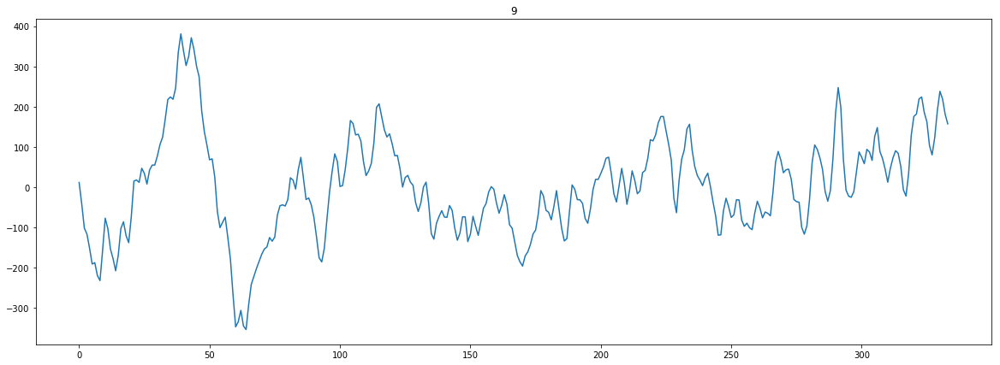

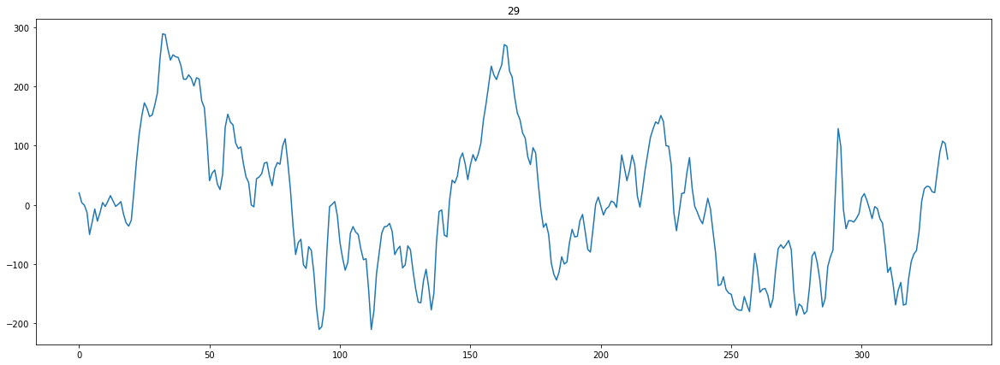

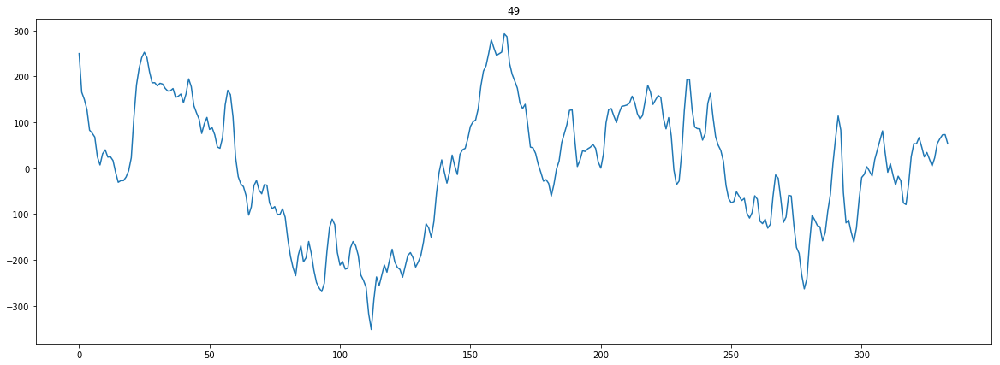

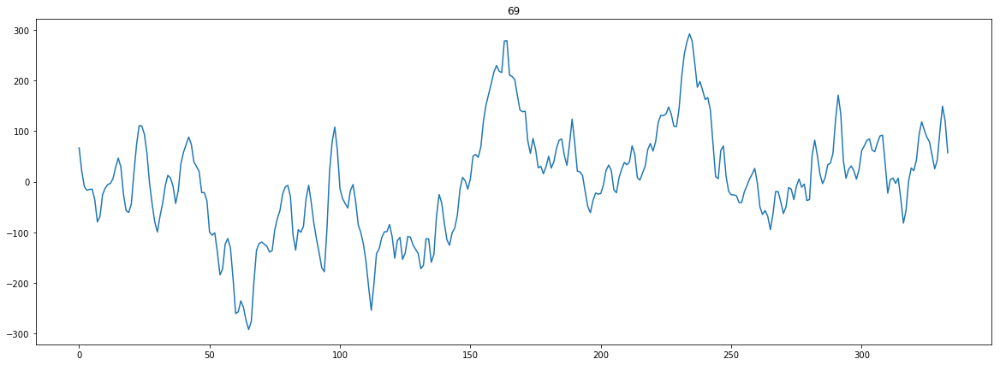

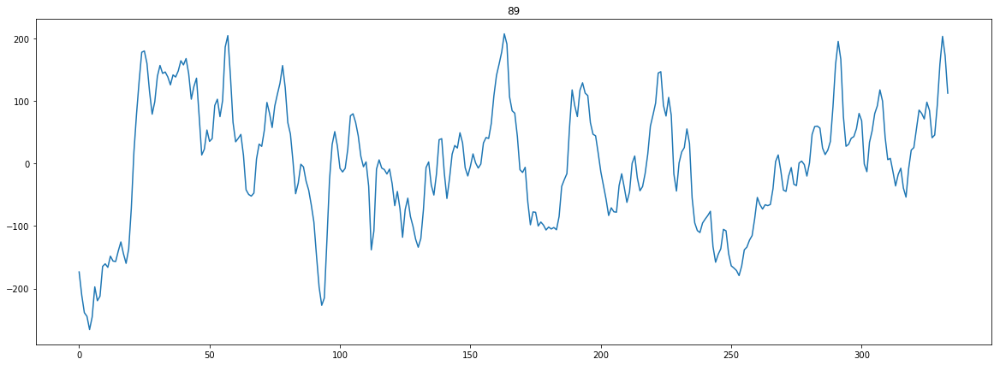

...

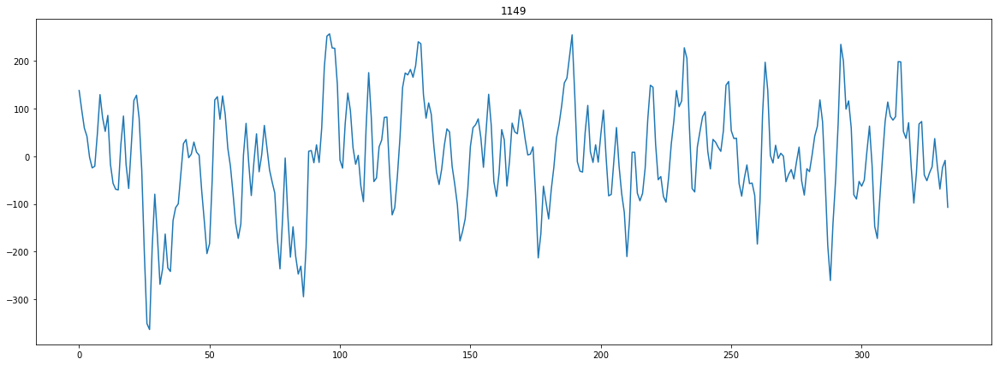

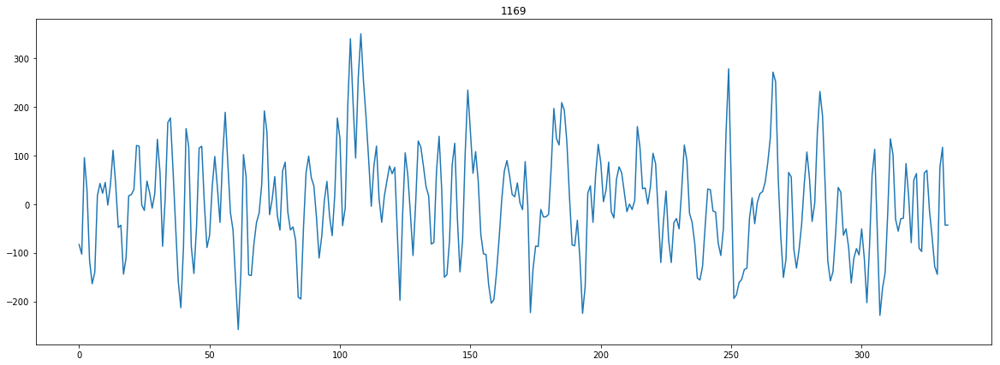

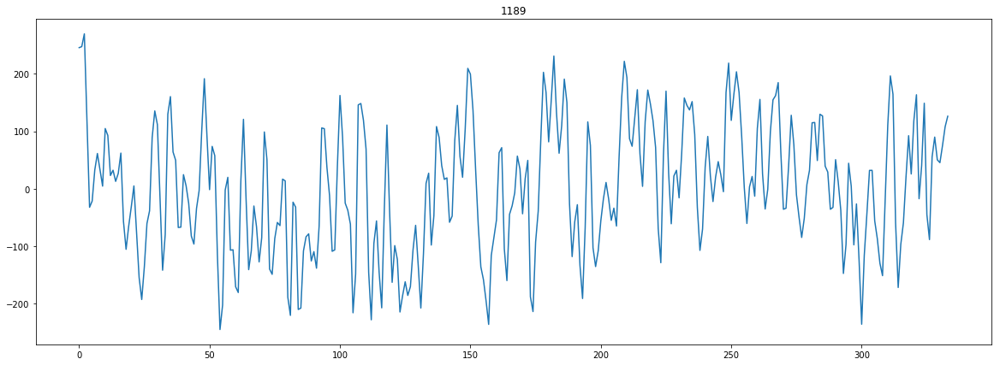

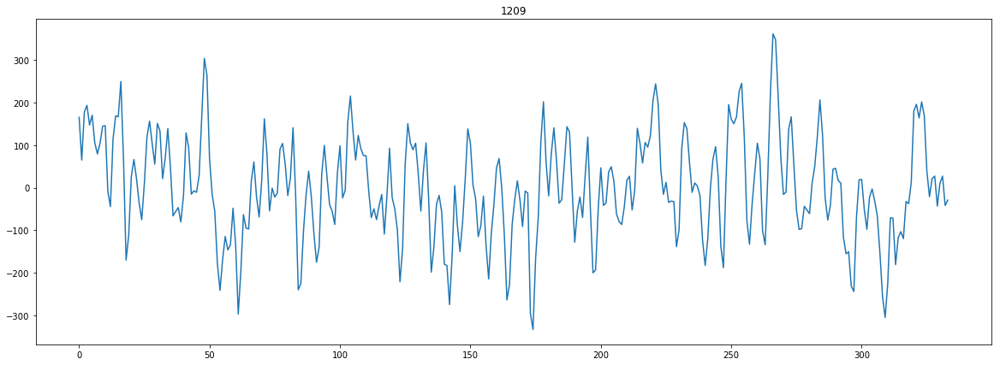

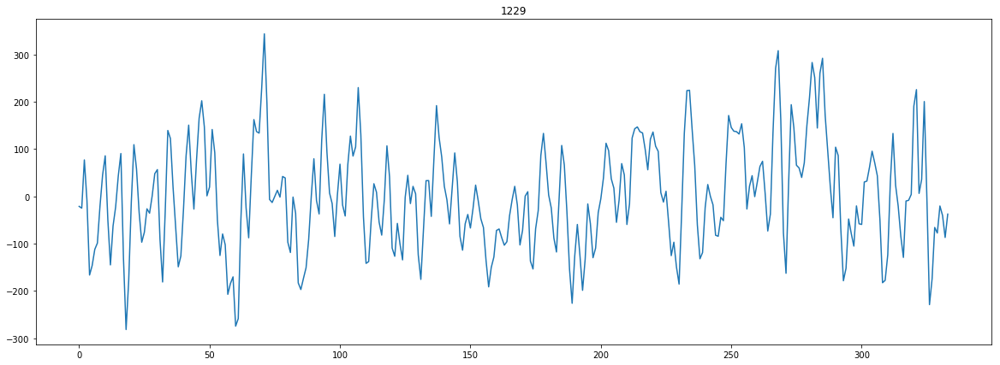

In [17]:
_, f, _ = filt_and_dsamp(10000, body_speed_limited_lowpass[10000])
for i in range(f.shape[-1]):
  plt.figure(figsize=(20,7))
  plt_data = f[:,i]
  plt.plot(plt_data)
  plt.title(str(good_channels[i]))

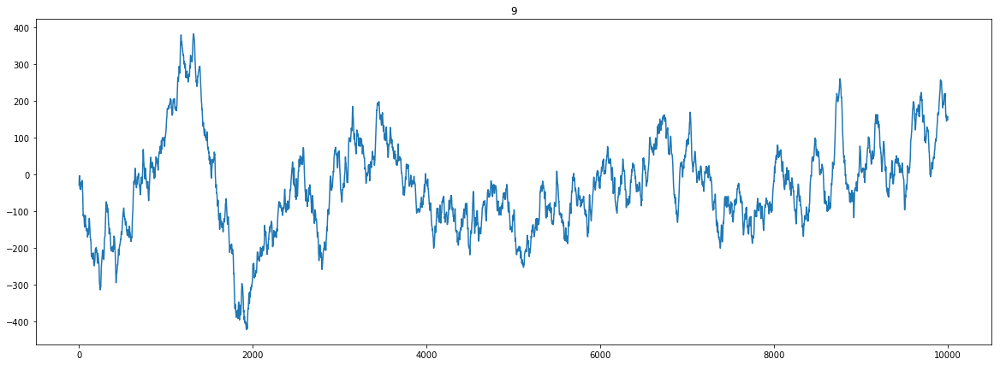

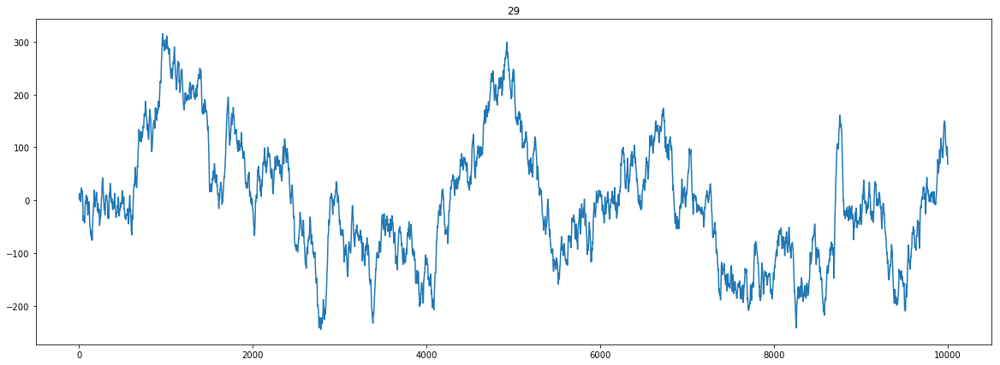

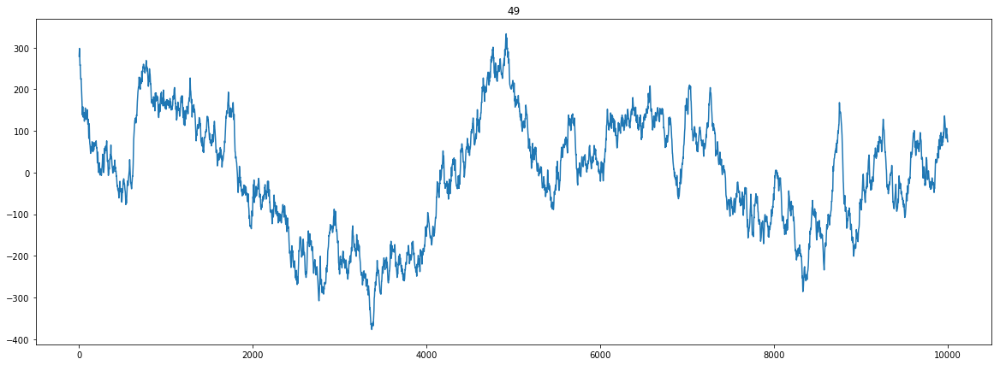

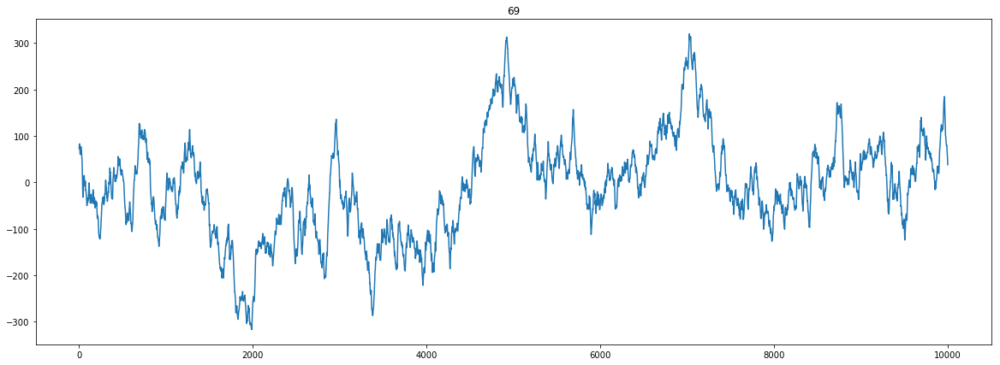

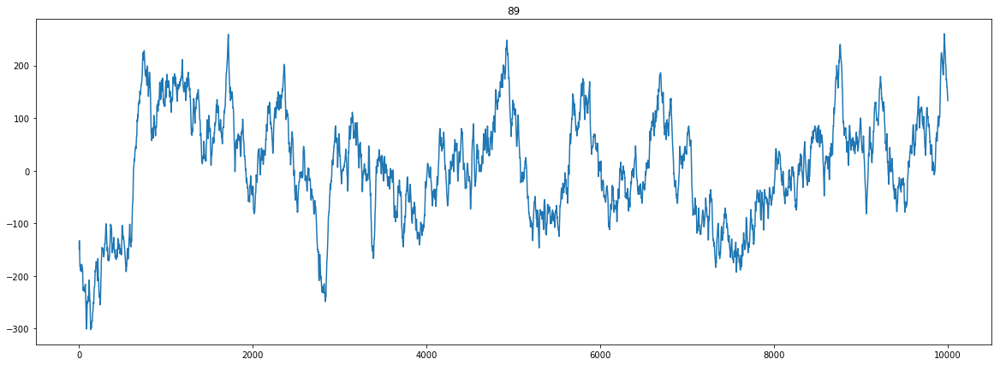

...

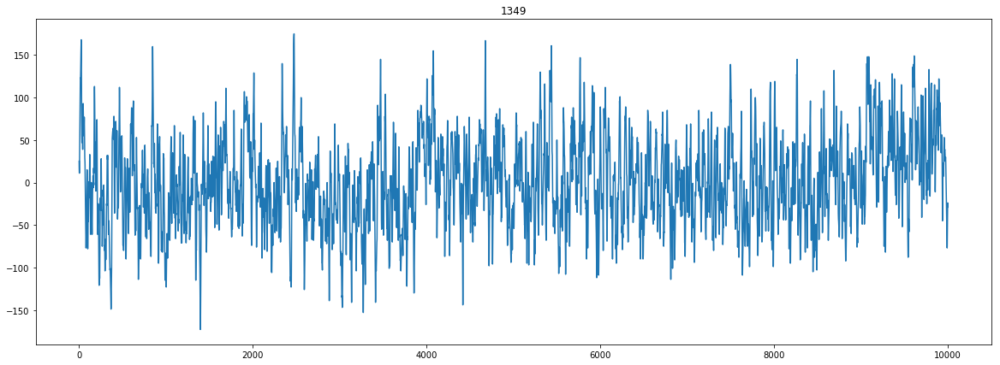

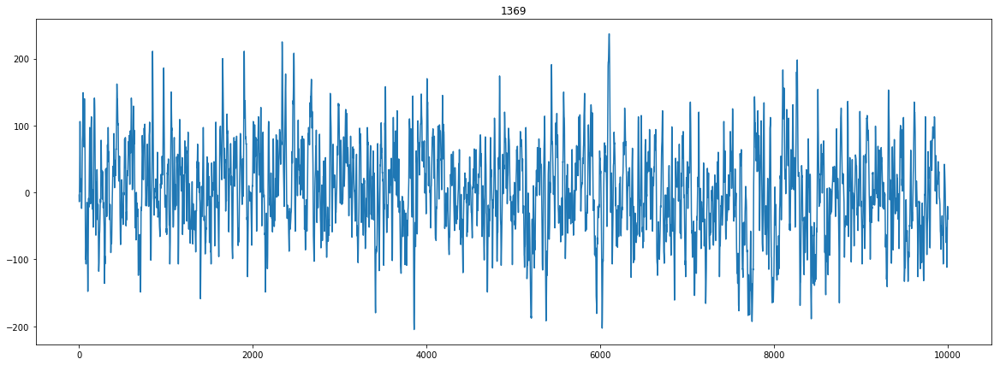

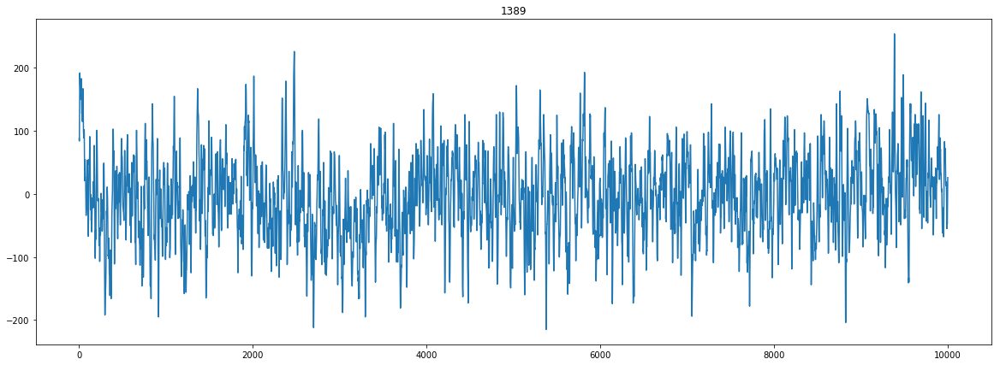

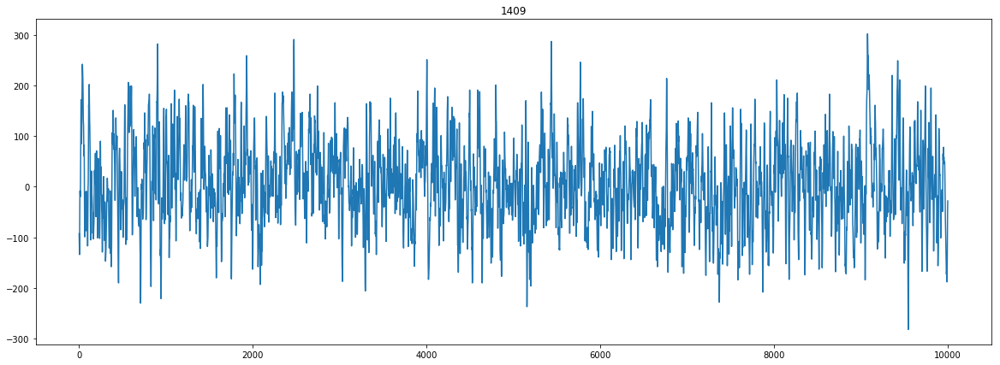

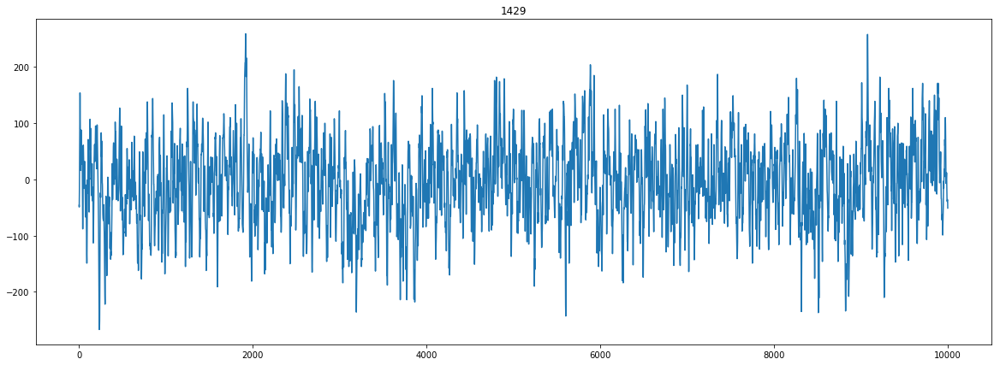

In [18]:
for i in range(all_data.shape[0]):
  frame_centre = np.where(frame_map==(10000+1))[0][0]
  chunk = all_data[:,frame_centre-interval:frame_centre]
  plt.figure(figsize=(20,7))
  all_data_f = chunk.astype(np.float32)
  plt.plot(all_data_f[i,:])
  plt.title(str(good_channels[i]))

Next we do the preprocessing for all frames. Note that it is an embarrassingly parallel procedure.

In [19]:
start_time = time.time()
full_data = Parallel(n_jobs=24)(delayed(filt_and_dsamp)(idx=i, frame_speed=f) \
                                for i,f in enumerate(body_speed_limited_lowpass[:-1000]))
end_time = time.time()

In [20]:
print("The time it took to go through all the preprocessing was {0}".format((end_time-start_time)/60))

The time it took to go through all the preprocessing was 164.786303333


Create the dataset

In [22]:
feature = np.empty((body_speed_limited_lowpass[:-1000].shape[0], 334, data_idxs.shape[0]), dtype=np.float32)
target = np.empty(body_speed_limited_lowpass[:-1000].shape[0])
while full_data:
  i, f, t = full_data.pop(0)
  feature[i,...] = f
  target[i] = t

Encode the target as one hot

In [25]:
target = preprocessing.OneHotEncoder(n_values=2, sparse=False).fit_transform(target.reshape(-1,1))

Select every 8000 samples as train and a 2000 as evaluation

In [28]:
block = np.ones(10000, dtype=np.int16)
block[8000:] = 0
total_idxs = np.empty(shape=target.shape[0], dtype=np.int)
for i in range(feature.shape[0]):
  total_idxs[i]=block[np.mod(i,10000)]

In [29]:
tr_idxs, ev_idxs = np.where(total_idxs==1)[0], np.where(total_idxs==0)[0]
LFP_features_train = feature[tr_idxs,...]
target_train = target[tr_idxs,:]
speeds_train = body_speed_limited_lowpass[tr_idxs]
LFP_features_eval = feature[ev_idxs,...]
target_eval = target[ev_idxs,:]
speeds_eval = body_speed_limited_lowpass[ev_idxs]
feature = None
total_idxs = None
cont_speeds = None
body_speed_limited_lowpass = None

Plot to make sure you still have the data

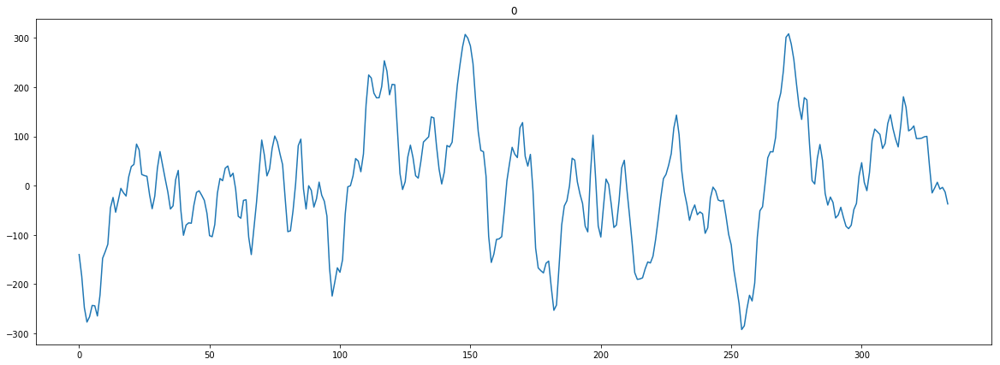

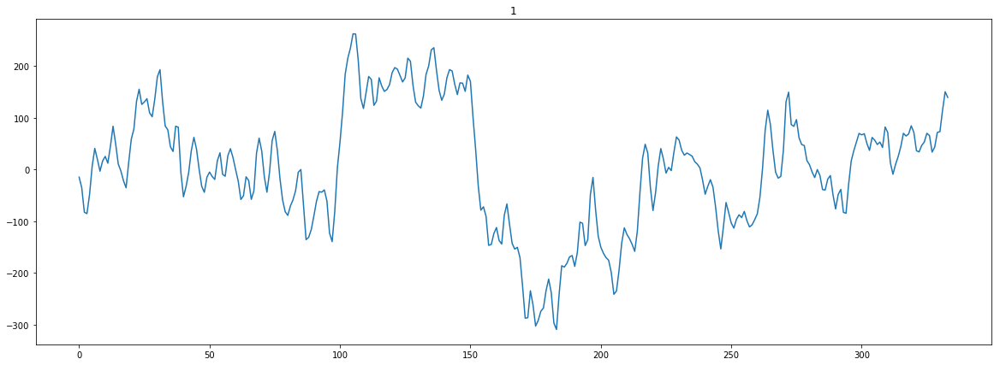

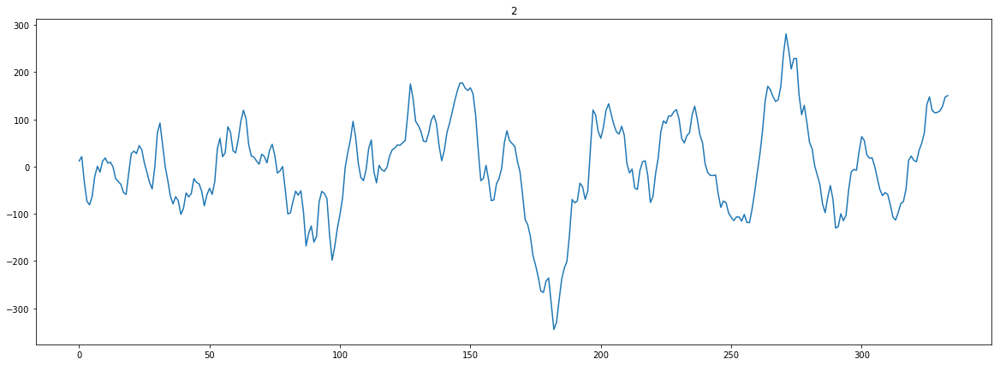

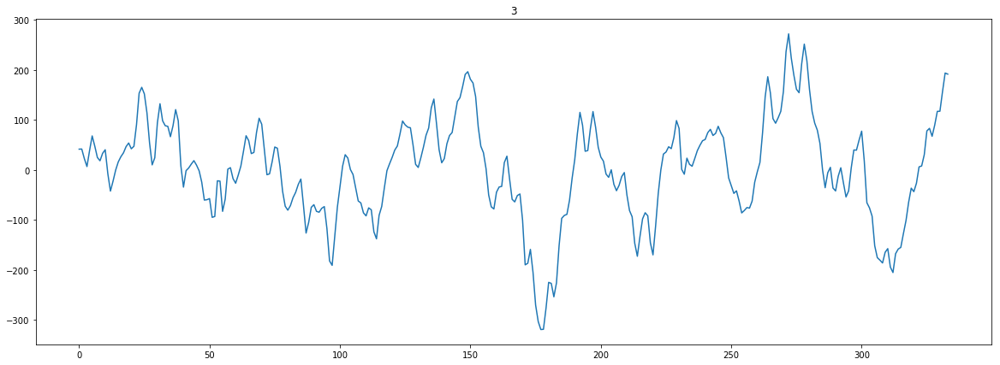

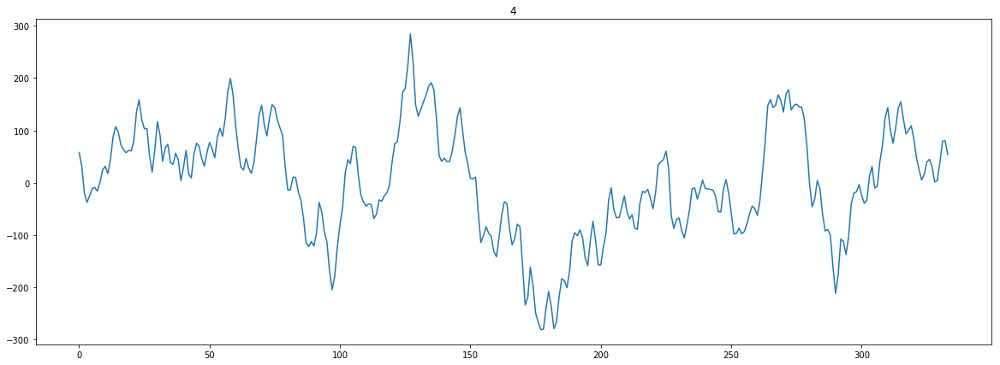

...

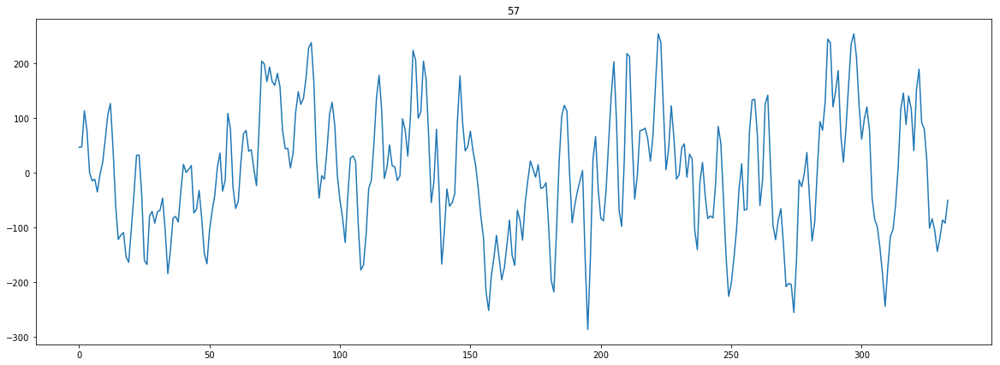

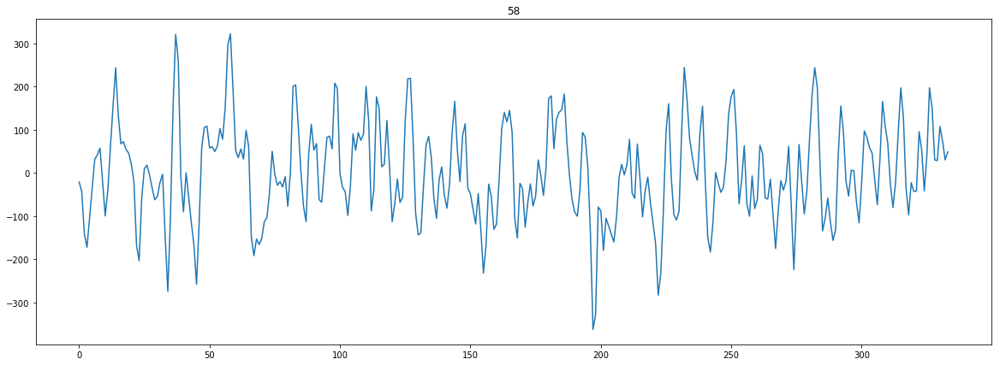

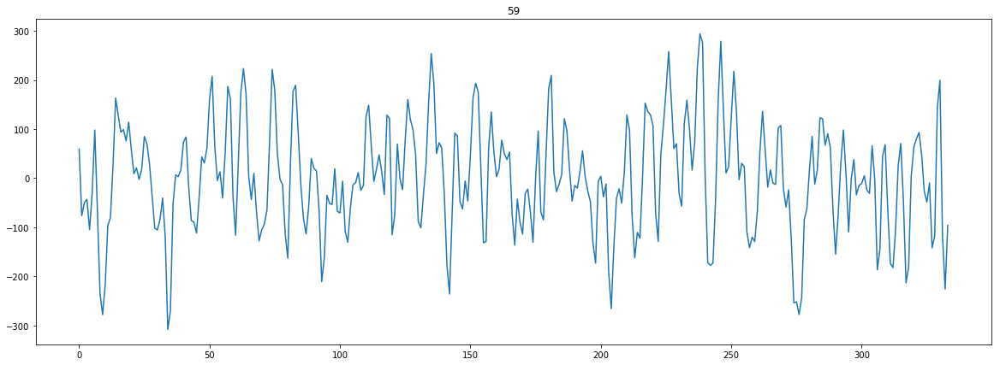

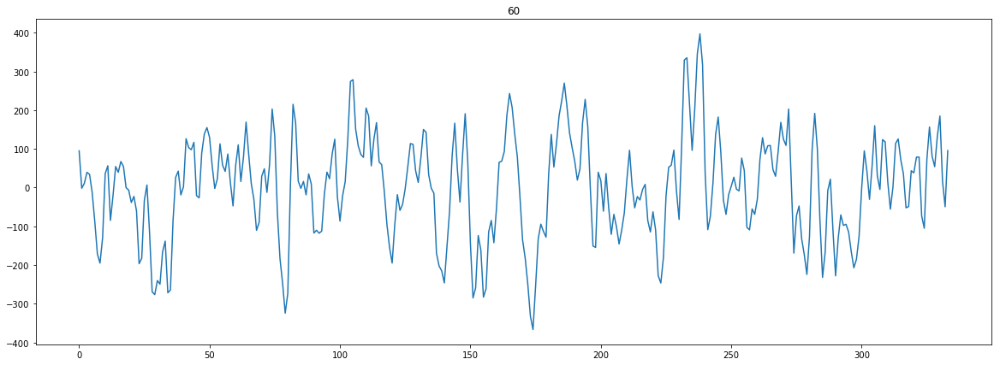

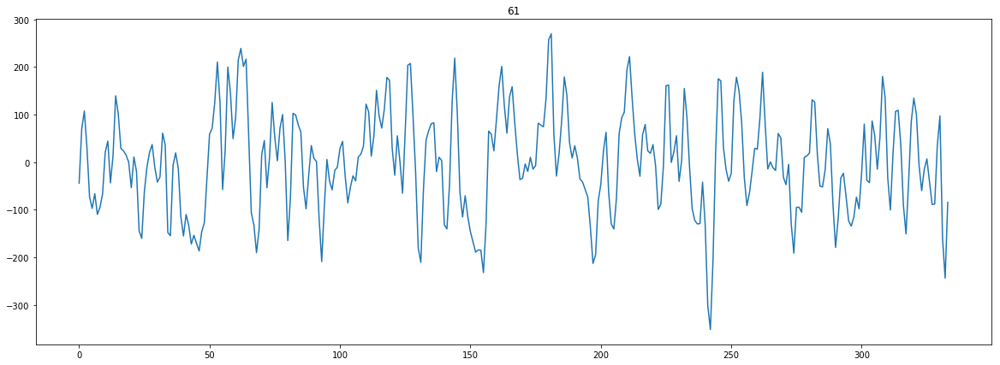

In [30]:
rand_i = np.random.randint(LFP_features_train.shape[0])
for i in range(LFP_features_train.shape[-1]):
  plt.figure(figsize=(20,7))
  plt_data = LFP_features_train[rand_i,:,i]
  plt.plot(plt_data)
  plt.title(str(i))

Normalize the features with the train set

In [33]:
features_flatten = LFP_features_train.reshape((LFP_features_train.shape[0],-1))
features_normalizer_path = '.../features_normalizer.pkl'
preprocessor=preprocessing.StandardScaler()
normalizer = preprocessor.fit(features_flatten)
with open(features_normalizer_path, 'w') as f:
  cPickle.dump(normalizer, f)
# normalizer = cPickle.load(open(features_normalizer_path))
features_normalized_flatten = normalizer.transform(features_flatten).astype(np.float32)
features_normalized = features_normalized_flatten.reshape(LFP_features_train.shape)

features_flatten = None
features_normalized_flatten = None
LFP_features_train = features_normalized

evals_flatten = LFP_features_eval.reshape((LFP_features_eval.shape[0],-1))
evals_normalized_flatten = normalizer.transform(evals_flatten).astype(np.float32)
evals_normalized = evals_normalized_flatten.reshape(LFP_features_eval.shape)

evals_flatten = None
evals_normalized_flatten = None
LFP_features_eval = evals_normalized

Plot after normalization

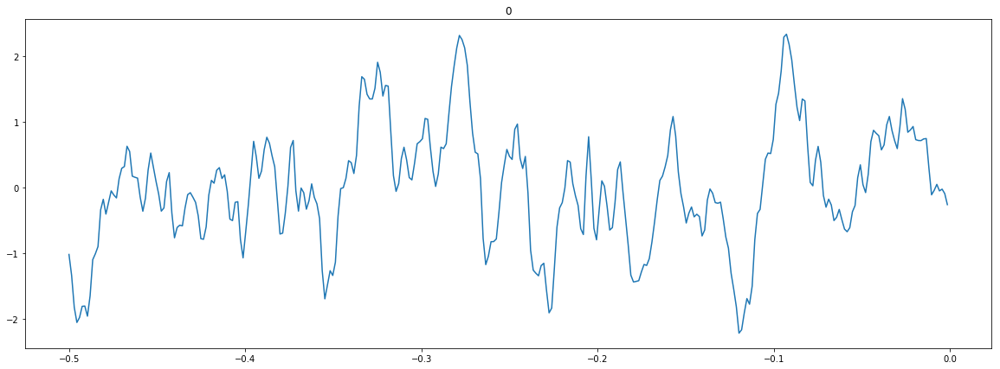

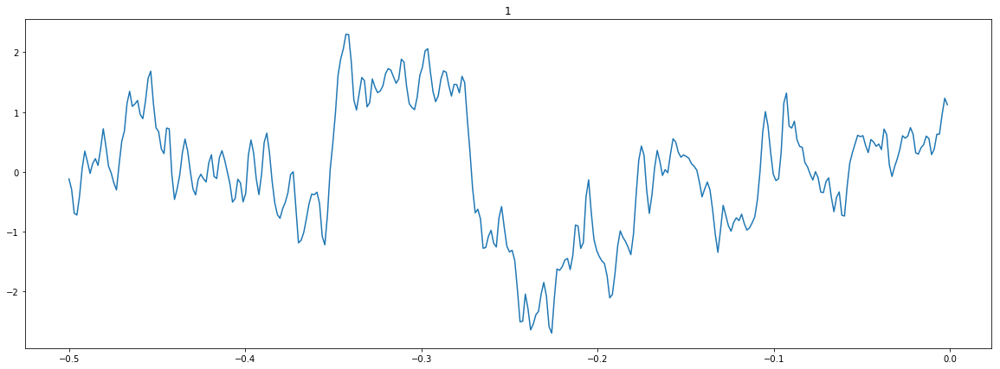

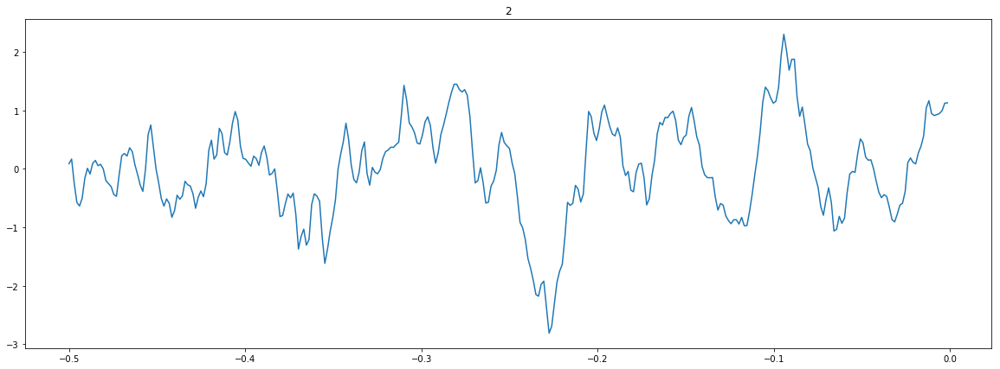

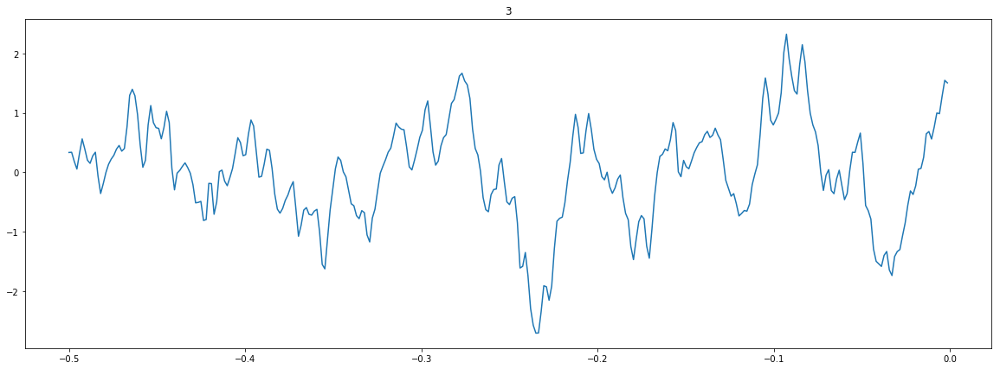

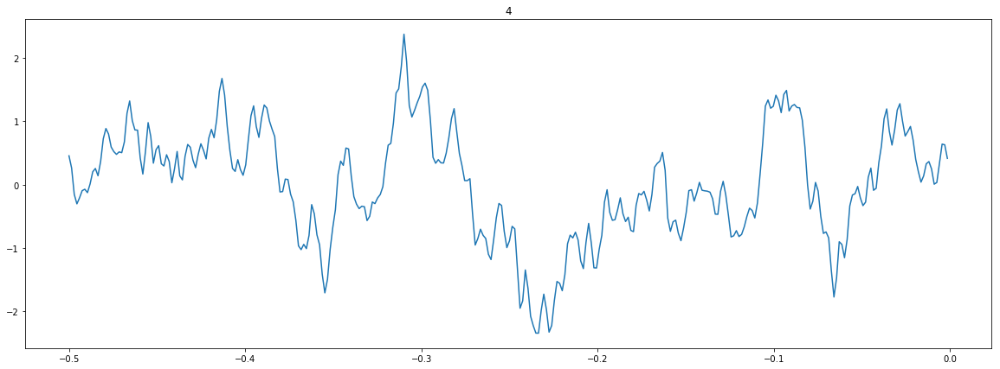

...

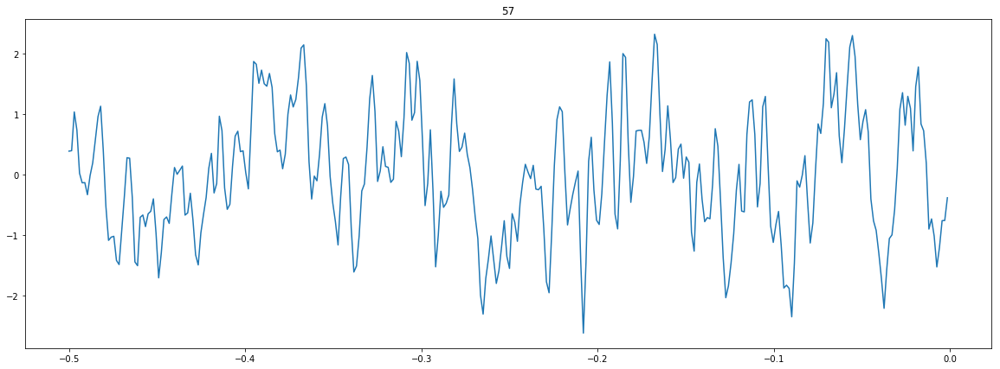

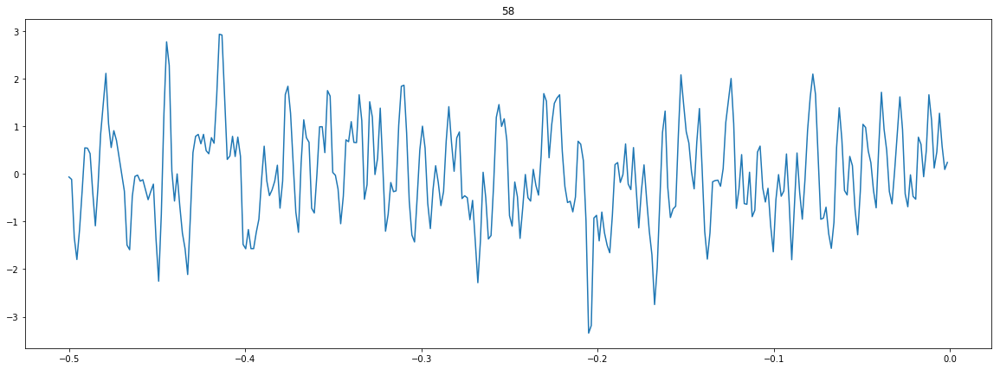

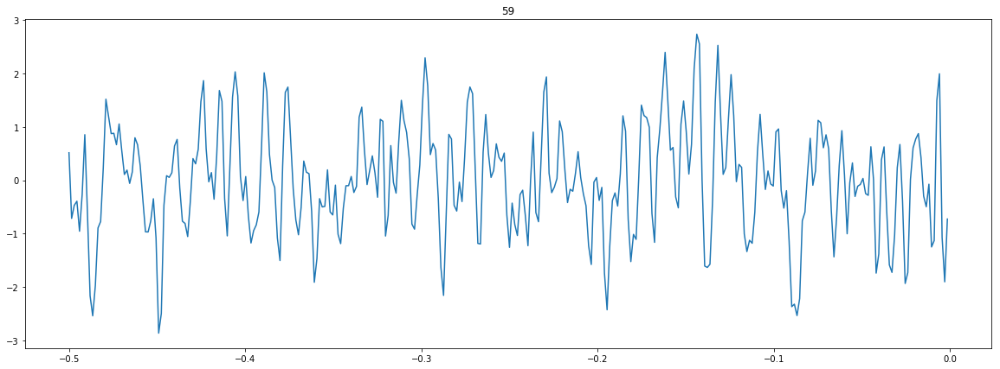

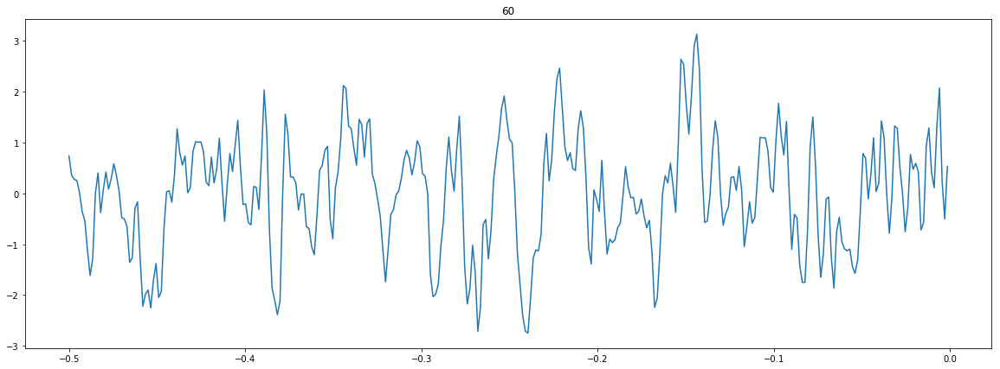

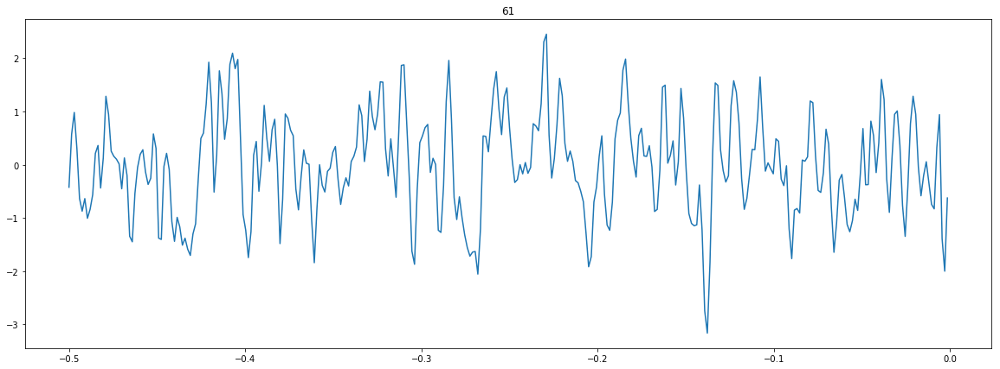

In [35]:
for i in range(LFP_features_train.shape[-1]):
  plt.figure(figsize=(20,7))
  plt_data = LFP_features_train[rand_i,:,i]
  plt.plot(np.arange(-0.5, 0., 0.5/plt_data.shape[0]), plt_data)
  plt.title(str(i))

Select 10 GB of data and save it

In [ ]:
selected_train_idxs = prng.choice(np.arange(LFP_features_train.shape[0]), 96608, replace=False)
selected_eval_idxs = prng.choice(np.arange(LFP_features_eval.shape[0]), 24152, replace=False)
LFP_features_train = LFP_features_train[selected_train_idxs,...]
speeds_train = speeds_train[selected_train_idxs,:]
cont_speeds_train = cont_speeds_train[selected_train_idxs,:]
LFP_features_eval = LFP_features_eval[selected_eval_idxs,...]
speeds_eval = speeds_eval[selected_eval_idxs,:]
cont_speeds_eval = cont_speeds_eval[selected_eval_idxs,:]

In [ ]:
with h5py.File("NS_LP_DS.h5", "w") as hf:
  hf.create_dataset("LFP_features_train", data=LFP_features_train)
  hf.create_dataset("targets_train", data=speeds_train)
  hf.create_dataset("speeds_train", data=cont_speeds_train)
  hf.create_dataset("LFP_features_eval", data=LFP_features_eval)
  hf.create_dataset("targets_eval", data=speeds_eval)
  hf.create_dataset("speeds_eval", data=cont_speeds_eval)